In [4]:
import os
import random
from PIL import Image
import torch
import torch.nn as nn
import torchvision.models as models
import torchvision.transforms as transforms
from torch.utils.data import Dataset, DataLoader

# ================================
# CONFIG
# ================================
training_dir = 'train'
batch_size = 8
num_epochs = 10
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# ================================
# DATASET: Siamese con coppie auto-generate
# ================================
class SiameseDataset(Dataset):
    def __init__(self, root_dir, transform=None):
        self.transform = transform or transforms.Compose([
            transforms.Resize((224, 224)),
            transforms.ToTensor()
        ])
        self.root_dir = root_dir

        self.class_to_imgs = {}
        for cls in os.listdir(root_dir):
            class_path = os.path.join(root_dir, cls)
            if os.path.isdir(class_path):
                self.class_to_imgs[cls] = [
                    os.path.join(class_path, f) for f in os.listdir(class_path)
                    if f.lower().endswith(('.jpg', '.jpeg', '.png'))
                ]

        self.classes = list(self.class_to_imgs.keys())
        self.pairs = self._generate_pairs()

    def _generate_pairs(self, num_pairs=1000):
        pairs = []

        for _ in range(num_pairs):
            # Positiva
            cls = random.choice(self.classes)
            imgs = random.sample(self.class_to_imgs[cls], 2)
            pairs.append((imgs[0], imgs[1], 1))

            # Negativa
            cls1, cls2 = random.sample(self.classes, 2)
            img1 = random.choice(self.class_to_imgs[cls1])
            img2 = random.choice(self.class_to_imgs[cls2])
            pairs.append((img1, img2, 0))

        return pairs

    def __getitem__(self, index):
        img1_path, img2_path, label = self.pairs[index]
        img1 = Image.open(img1_path).convert('RGB')
        img2 = Image.open(img2_path).convert('RGB')
        return self.transform(img1), self.transform(img2), torch.tensor(label, dtype=torch.float32)

    def __len__(self):
        return len(self.pairs)

# ================================
# MODEL: Siamese Network
# ================================
class SiameseNetwork(nn.Module):
    def __init__(self):
        super(SiameseNetwork, self).__init__()
        self.backbone = models.resnet18(pretrained=True)
        self.backbone.fc = nn.Identity()  # Rimuove classificazione finale
        self.embedding_dim = 512

        self.fc = nn.Sequential(
            nn.Linear(self.embedding_dim, 256),
            nn.ReLU(),
            nn.Linear(256, 128)
        )

    def forward_once(self, x):
        x = self.backbone(x)
        x = self.fc(x)
        return x

    def forward(self, x1, x2):
        return self.forward_once(x1), self.forward_once(x2)

# ================================
# LOSS: Contrastive
# ================================
class ContrastiveLoss(nn.Module):
    def __init__(self, margin=1.0):
        super(ContrastiveLoss, self).__init__()
        self.margin = margin

    def forward(self, out1, out2, label):
        euclidean = nn.functional.pairwise_distance(out1, out2)
        loss = torch.mean((1 - label) * torch.pow(euclidean, 2) +
                          label * torch.pow(torch.clamp(self.margin - euclidean, min=0.0), 2))
        return loss

# ================================
# TRAINING
# ================================
dataset = SiameseDataset(train_dir)
dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True)

model = SiameseNetwork().to(device)
criterion = ContrastiveLoss()
optimizer = torch.optim.Adam(model.parameters(), lr=1e-4)

print("🚀 Inizio training...")
for epoch in range(num_epochs):
    model.train()
    total_loss = 0
    for img1, img2, labels in dataloader:
        img1, img2, labels = img1.to(device), img2.to(device), labels.to(device)

        out1, out2 = model(img1, img2)
        loss = criterion(out1, out2, labels)
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        total_loss += loss.item()

    print(f"Epoch {epoch+1}/{num_epochs} | Loss: {total_loss / len(dataloader):.4f}")
print("✅ Fine allenamento.")


NameError: name 'train_dir' is not defined

In [ ]:
from sklearn.metrics.pairwise import cosine_similarity
import json

# Cartelle
gallery_dir = 'test/gallery'
query_dir   = 'test/query'

# Trasformazioni da usare anche qui
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor()
])

def extract_embedding(image_path, model):
    image = Image.open(image_path).convert('RGB')
    image = transform(image).unsqueeze(0).to(device)
    model.eval()
    with torch.no_grad():
        embedding = model.forward_once(image)
    return embedding.cpu().numpy().flatten()

# Estrai feature galleria
gallery_paths = [os.path.join(gallery_dir, f) for f in os.listdir(gallery_dir)]
gallery_embeddings = [extract_embedding(p, model) for p in gallery_paths]

# Estrai feature query
query_paths = [os.path.join(query_dir, f) for f in os.listdir(query_dir)]

results = []
top_k = 10  # Numero di immagini simili da restituire

for q_path in query_paths:
    q_emb = extract_embedding(q_path, model).reshape(1, -1)
    sims = cosine_similarity(q_emb, gallery_embeddings)[0]
    top_indices = sims.argsort()[::-1][:top_k]
    similar_images = [gallery_paths[i] for i in top_indices]
    results.append({
        "filename": q_path,
        "gallery_images": similar_images
    })

# Salva in JSON
     # Salva o stampa il risultato in formato JSON
    with open('submission3.json', 'w') as f:
        json.dump(results, f, indent=2)

    print('submission ok')


submission ok
submission ok


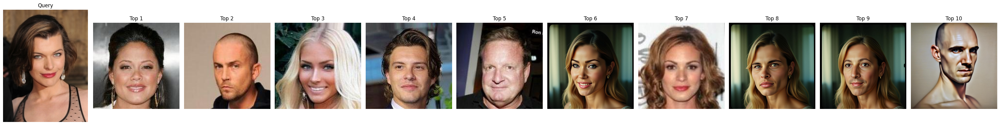

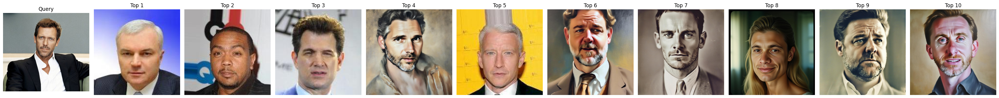

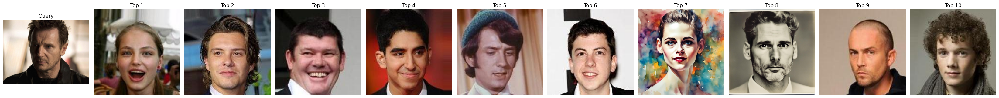

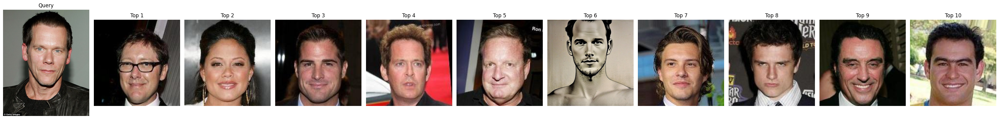

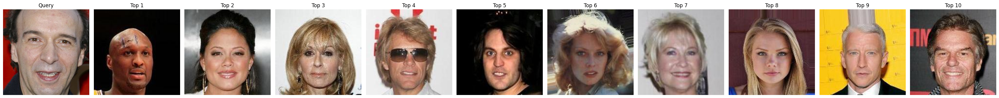

In [2]:
import json
import matplotlib.pyplot as plt
from PIL import Image

# Load submission file
with open('submission8.json', 'r') as f:
    results = json.load(f)

# How many queries to show?
num_queries_to_show = 5
top_k = len(results[0]['gallery_images'])

# Plot
for i, item in enumerate(results[:num_queries_to_show]):
    query_img = Image.open(item['filename']).convert('RGB')

    fig, axs = plt.subplots(1, top_k + 1, figsize=(3 * (top_k + 1), 4))
    axs[0].imshow(query_img)
    axs[0].set_title("Query")
    axs[0].axis('off')

    for j, gallery_path in enumerate(item['gallery_images']):
        gallery_img = Image.open(gallery_path).convert('RGB')
        axs[j + 1].imshow(gallery_img)
        axs[j + 1].set_title(f"Top {j+1}")
        axs[j + 1].axis('off')

    plt.tight_layout()
    plt.show()

In [7]:
import os
import random
import numpy as np
from PIL import Image
import torch
import torch.nn as nn
import torch.nn.functional as F
import torchvision.models as models
import torchvision.transforms as transforms
from sklearn.metrics.pairwise import cosine_similarity
import json

# ================================
# CONFIGURAZIONE
# ================================
class Config:
    # Directory paths
    gallery_dir = 'test/gallery'
    query_dir = 'test/query'
    model_path = 'best_siamese_model.pth'
    output_json = 'submission7.json'
    
    # Training parameters - MODIFICA QUI I PARAMETRI DI TRAINING
    batch_size = 16
    num_epochs = 10          # ← CAMBIA QUI IL NUMERO DI EPOCH
    learning_rate = 1e-4    # ← CAMBIA QUI IL LEARNING RATE
    embedding_dim = 256     # ← CAMBIA QUI LA DIMENSIONE DELL'EMBEDDING
    margin = 2.0           # ← CAMBIA QUI IL MARGIN PER LA CONTRASTIVE LOSS
    num_pairs = 2000       # ← CAMBIA QUI IL NUMERO DI COPPIE PER TRAINING
    top_k = 10              # ← CAMBIA QUI IL NUMERO DI RISULTATI TOP-K
    
    # Model parameters
    dropout_rate = 0.3     # ← CAMBIA QUI IL DROPOUT RATE
    hidden_dim = 512       # ← CAMBIA QUI LA DIMENSIONE HIDDEN LAYER
    
    # Device configuration
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    
    # Data augmentation and preprocessing
    use_data_augmentation = True  # ← ATTIVA/DISATTIVA DATA AUGMENTATION
    
    # Trasformazioni per training (con data augmentation)
    train_transform = transforms.Compose([
        transforms.Resize((256, 256)),
        transforms.RandomCrop((224, 224)),
        transforms.RandomHorizontalFlip(p=0.5),
        transforms.RandomRotation(degrees=15),
        transforms.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2, hue=0.1),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
    ])
    
    # Trasformazioni per test (senza augmentation)
    test_transform = transforms.Compose([
        transforms.Resize((224, 224)),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
    ])
    
    @classmethod
    def print_config(cls):
        """Stampa la configurazione corrente"""
        print("🔧 CONFIGURAZIONE CORRENTE")
        print("=" * 50)
        print(f"📁 Gallery directory: {cls.gallery_dir}")
        print(f"📁 Query directory: {cls.query_dir}")
        print(f"💾 Model path: {cls.model_path}")
        print(f"📄 Output JSON: {cls.output_json}")
        print("\n🎯 PARAMETRI DI TRAINING:")
        print(f"   Batch size: {cls.batch_size}")
        print(f"   Num epochs: {cls.num_epochs}")
        print(f"   Learning rate: {cls.learning_rate}")
        print(f"   Embedding dim: {cls.embedding_dim}")
        print(f"   Margin: {cls.margin}")
        print(f"   Num pairs: {cls.num_pairs}")
        print(f"   Top-K: {cls.top_k}")
        print(f"   Dropout rate: {cls.dropout_rate}")
        print(f"   Hidden dim: {cls.hidden_dim}")
        print(f"   Data augmentation: {cls.use_data_augmentation}")
        print(f"   Device: {cls.device}")
        print("=" * 50)
    
    @classmethod
    def update_training_params(cls, **kwargs):
        """Aggiorna i parametri di training dinamicamente"""
        updated = []
        for key, value in kwargs.items():
            if hasattr(cls, key):
                old_value = getattr(cls, key)
                setattr(cls, key, value)
                updated.append(f"{key}: {old_value} → {value}")
            else:
                print(f"⚠️  Parametro sconosciuto: {key}")
        
        if updated:
            print("✅ Parametri aggiornati:")
            for update in updated:
                print(f"   {update}")

# ================================
# MODELLO SIAMESE
# ================================
class SiameseNetwork(nn.Module):
    def __init__(self, embedding_dim=None, dropout_rate=None, hidden_dim=None):
        super(SiameseNetwork, self).__init__()
        
        # Usa i parametri dalla Config se non specificati
        if embedding_dim is None:
            embedding_dim = Config.embedding_dim
        if dropout_rate is None:
            dropout_rate = Config.dropout_rate
        if hidden_dim is None:
            hidden_dim = Config.hidden_dim
        
        # Backbone: ResNet18 pre-addestrato
        self.backbone = models.resnet18(pretrained=True)
        
        # Rimuovi l'ultimo layer di classificazione
        num_features = self.backbone.fc.in_features
        self.backbone.fc = nn.Identity()
        
        # Embedding layers con parametri configurabili
        self.embedding = nn.Sequential(
            nn.Linear(num_features, hidden_dim),
            nn.ReLU(inplace=True),
            nn.Dropout(dropout_rate),
            nn.Linear(hidden_dim, embedding_dim),
            nn.ReLU(inplace=True),
            nn.Dropout(dropout_rate * 0.7),  # Dropout più leggero nel secondo layer
            nn.Linear(embedding_dim, embedding_dim)
        )
        
        print(f"🏗️  Modello creato con:")
        print(f"   Embedding dim: {embedding_dim}")
        print(f"   Hidden dim: {hidden_dim}")
        print(f"   Dropout rate: {dropout_rate}")
    
    def forward_once(self, x):
        features = self.backbone(x)
        embedding = self.embedding(features)
        # Normalizza l'embedding per stabilità
        embedding = F.normalize(embedding, p=2, dim=1)
        return embedding
    
    def forward(self, x1, x2):
        emb1 = self.forward_once(x1)
        emb2 = self.forward_once(x2)
        return emb1, emb2

# ================================
# CONTRASTIVE LOSS
# ================================
class ContrastiveLoss(nn.Module):
    def __init__(self, margin=None):
        super(ContrastiveLoss, self).__init__()
        self.margin = margin if margin is not None else Config.margin
        print(f"📊 Contrastive Loss creata con margin: {self.margin}")
    
    def forward(self, output1, output2, label):
        euclidean_distance = F.pairwise_distance(output1, output2, keepdim=True)
        loss_contrastive = torch.mean((1-label) * torch.pow(euclidean_distance, 2) +
                                    (label) * torch.pow(torch.clamp(self.margin - euclidean_distance, min=0.0), 2))
        return loss_contrastive

# ================================
# FUNZIONI DI UTILITÀ
# ================================
def load_model():
    """Carica il modello addestrato con parametri dalla Config"""
    model = SiameseNetwork().to(Config.device)
    
    if os.path.exists(Config.model_path):
        model.load_state_dict(torch.load(Config.model_path, map_location=Config.device))
        print(f"✅ Modello caricato da {Config.model_path}")
    else:
        print(f"⚠️  Modello non trovato in {Config.model_path}. Usando modello non addestrato.")
    
    model.eval()
    return model

def extract_embedding(image_path, model):
    """Estrae embedding da una singola immagine"""
    try:
        image = Image.open(image_path).convert('RGB')
        image = Config.test_transform(image).unsqueeze(0).to(Config.device)
        
        with torch.no_grad():
            embedding = model.forward_once(image)
        
        return embedding.cpu().numpy().flatten()
    except Exception as e:
        print(f"❌ Errore nell'estrazione embedding da {image_path}: {e}")
        return None

def get_image_paths(directory):
    """Ottiene tutti i percorsi delle immagini in una directory"""
    if not os.path.exists(directory):
        print(f"❌ Directory non trovata: {directory}")
        return []
    
    valid_extensions = ('.jpg', '.jpeg', '.png', '.bmp', '.tiff', '.webp')
    image_paths = []
    
    for filename in os.listdir(directory):
        if filename.lower().endswith(valid_extensions):
            image_paths.append(os.path.join(directory, filename))
    
    return sorted(image_paths)

def generate_similarity_json():
    """Genera il file JSON con i risultati di similarità"""
    print("🔍 Generazione JSON per similarità immagini...")
    print("=" * 50)
    
    # Stampa configurazione corrente
    Config.print_config()
    
    # Carica il modello
    model = load_model()
    
    # Ottieni percorsi immagini
    gallery_paths = get_image_paths(Config.gallery_dir)
    query_paths = get_image_paths(Config.query_dir)
    
    if not gallery_paths:
        print(f"❌ Nessuna immagine trovata in {Config.gallery_dir}")
        return
    
    if not query_paths:
        print(f"❌ Nessuna immagine trovata in {Config.query_dir}")
        return
    
    print(f"📁 Gallery: {len(gallery_paths)} immagini")
    print(f"📁 Query: {len(query_paths)} immagini")
    
    # Estrai embedding per tutte le immagini gallery
    print("\n🧮 Estrazione embedding gallery...")
    gallery_embeddings = []
    valid_gallery_paths = []
    
    for i, path in enumerate(gallery_paths):
        if i % 50 == 0:
            print(f"Processando gallery {i+1}/{len(gallery_paths)}")
        
        emb = extract_embedding(path, model)
        if emb is not None:
            gallery_embeddings.append(emb)
            valid_gallery_paths.append(path)
    
    if not gallery_embeddings:
        print("❌ Nessun embedding valido estratto dalla gallery")
        return
    
    gallery_embeddings = np.array(gallery_embeddings)
    print(f"✅ Estratti {len(gallery_embeddings)} embedding dalla gallery")
    
    # Processa ogni query e trova le immagini più simili
    print(f"\n🔍 Ricerca top-{Config.top_k} immagini simili per ogni query...")
    results = []
    
    for i, query_path in enumerate(query_paths):
        if i % 10 == 0:
            print(f"Processando query {i+1}/{len(query_paths)}")
        
        # Estrai embedding della query
        query_emb = extract_embedding(query_path, model)
        if query_emb is None:
            print(f"⚠️  Saltando {query_path} (errore estrazione embedding)")
            continue
        
        # Calcola similarità con tutte le immagini gallery
        query_emb = query_emb.reshape(1, -1)
        similarities = cosine_similarity(query_emb, gallery_embeddings)[0]
        
        # Trova le top-k immagini più simili
        top_indices = similarities.argsort()[::-1][:Config.top_k]
        similar_images = [valid_gallery_paths[idx] for idx in top_indices]
        
        # Formato semplice richiesto: filename + gallery_images
        result_entry = {
            "filename": query_path,
            "gallery_images": similar_images
        }
        results.append(result_entry)
        
        # Debug: mostra similarità per le prime query
        if i < 3:
            print(f"\n📊 Query: {os.path.basename(query_path)}")
            for j, idx in enumerate(top_indices):
                sim_score = similarities[idx]
                img_name = os.path.basename(valid_gallery_paths[idx])
                print(f"  {j+1}. {img_name} (similarità: {sim_score:.4f})")
            print(f"  → Formato finale: filename + {len(similar_images)} gallery_images")
    
    # Salva risultati in JSON
    print(f"\n💾 Salvataggio risultati in {Config.output_json}...")
    with open(Config.output_json, 'w') as f:
        json.dump(results, f, indent=2)
    
    print(f"✅ JSON generato con successo!")
    print(f"📄 File: {Config.output_json}")
    print(f"📊 Query processate: {len(results)}")
    print(f"🎯 Top-{Config.top_k} immagini simili per ogni query")
    
    return results

def validate_json_format():
    """Valida il formato del JSON generato"""
    if not os.path.exists(Config.output_json):
        print(f"❌ File {Config.output_json} non trovato")
        return False
    
    try:
        with open(Config.output_json, 'r') as f:
            data = json.load(f)
        
        print(f"\n🔍 Validazione formato JSON...")
        print(f"📊 Numero di entries: {len(data)}")
        
        # Controlla il formato della prima entry
        if data:
            first_entry = data[0]
            required_keys = ['filename', 'gallery_images']
            
            for key in required_keys:
                if key not in first_entry:
                    print(f"❌ Chiave mancante: {key}")
                    return False
            
            print(f"✅ Formato corretto!")
            print(f"📝 Esempio prima entry:")
            print(f"   filename: {os.path.basename(first_entry['filename'])}")
            print(f"   gallery_images: {len(first_entry['gallery_images'])} immagini")
            print(f"   📄 Struttura: [{{\"filename\": \"...\", \"gallery_images\": [...]}}]")
            
            return True
        else:
            print("❌ JSON vuoto")
            return False
            
    except json.JSONDecodeError as e:
        print(f"❌ Errore formato JSON: {e}")
        return False

# ================================
# FUNZIONI PER MODIFICARE PARAMETRI
# ================================
def quick_config_update(**kwargs):
    """Funzione rapida per aggiornare la configurazione"""
    print("🔧 Aggiornamento configurazione...")
    Config.update_training_params(**kwargs)
    print("\n📋 Configurazione aggiornata:")
    Config.print_config()

def training_preset_light():
    """Preset per training leggero e veloce"""
    Config.update_training_params(
        batch_size=32,
        num_epochs=3,
        learning_rate=1e-3,
        embedding_dim=128,
        margin=1.5,
        num_pairs=1000,
        dropout_rate=0.2
    )
    print("🚀 Preset LIGHT applicato - Training veloce")

def training_preset_heavy():
    """Preset per training intensivo e accurato"""
    Config.update_training_params(
        batch_size=8,
        num_epochs=15,
        learning_rate=5e-5,
        embedding_dim=512,
        margin=3.0,
        num_pairs=5000,
        dropout_rate=0.4
    )
    print("🔥 Preset HEAVY applicato - Training intensivo")

def training_preset_balanced():
    """Preset bilanciato tra velocità e accuratezza"""
    Config.update_training_params(
        batch_size=16,
        num_epochs=8,
        learning_rate=1e-4,
        embedding_dim=256,
        margin=2.0,
        num_pairs=3000,
        dropout_rate=0.3
    )
    print("⚖️  Preset BALANCED applicato - Training bilanciato")

# ================================
# MAIN
# ================================
if __name__ == "__main__":
    print("🎯 Generatore JSON per Similarità Immagini")
    print("=" * 50)
    
    # Esempi di come modificare i parametri:
    
    # 1. Modifica singoli parametri
    # Config.update_training_params(num_epochs=10, learning_rate=5e-5)
    
    # 2. Modifica multipli parametri
    # quick_config_update(batch_size=32, num_epochs=8, embedding_dim=512)
    
    # 3. Usa preset predefiniti
    # training_preset_light()    # Per training veloce
    # training_preset_heavy()    # Per training intensivo  
    # training_preset_balanced() # Per training bilanciato
    
    # Genera il JSON
    results = generate_similarity_json()
    
    if results:
        # Valida il formato
        validate_json_format()
        
        print("\n🎉 Processo completato!")
        print(f"📁 File generato: {Config.output_json}")
    else:
        print("❌ Errore nella generazione del JSON")

# ================================
# FUNZIONE PER GENERARE DATI MOCK (se non hai il modello)
# ================================
def generate_mock_json():
    """Genera un JSON di esempio se non hai il modello addestrato"""
    print("🎭 Generazione JSON mock per test...")
    
    gallery_paths = get_image_paths(Config.gallery_dir)
    query_paths = get_image_paths(Config.query_dir)
    
    if not gallery_paths or not query_paths:
        print("❌ Directory gallery o query non trovate")
        return
    
    results = []
    for query_path in query_paths:
        # Seleziona immagini casuali dalla gallery (senza ripetizioni)
        similar_images = random.sample(gallery_paths, min(Config.top_k, len(gallery_paths)))
        
        # Formato richiesto: filename + gallery_images  
        results.append({
            "res": query_path,
            "gallery_images": similar_images
        })
    
    # Salva JSON mock
    mock_filename = 'submission_mock.json'
    with open(mock_filename, 'w') as f:
        json.dump(results, f, indent=2)
    
    print(f"✅ JSON mock generato: {mock_filename}")
    return results

# Decommenta per generare dati mock se non hai il modello
# generate_mock_json()

# ================================
# ESEMPI DI UTILIZZO
# ================================
"""
ESEMPI DI COME MODIFICARE I PARAMETRI:

1. Modifica parametri singoli:
   Config.batch_size = 32
   Config.num_epochs = 10
   Config.learning_rate = 5e-5

2. Modifica parametri multipli:
   Config.update_training_params(
       batch_size=32,
       num_epochs=10, 
       learning_rate=5e-5,
       embedding_dim=512
   )

3. Usa preset predefiniti:
   training_preset_light()     # Training veloce
   training_preset_heavy()     # Training intensivo
   training_preset_balanced()  # Training bilanciato

4. Modifica rapida:
   quick_config_update(num_epochs=15, batch_size=8)

5. Visualizza configurazione corrente:
   Config.print_config()
"""

🎯 Generatore JSON per Similarità Immagini
🔍 Generazione JSON per similarità immagini...
🔧 CONFIGURAZIONE CORRENTE
📁 Gallery directory: test/gallery
📁 Query directory: test/query
💾 Model path: best_siamese_model.pth
📄 Output JSON: submission7.json

🎯 PARAMETRI DI TRAINING:
   Batch size: 16
   Num epochs: 10
   Learning rate: 0.0001
   Embedding dim: 256
   Margin: 2.0
   Num pairs: 2000
   Top-K: 10
   Dropout rate: 0.3
   Hidden dim: 512
   Data augmentation: True
   Device: cpu
🏗️  Modello creato con:
   Embedding dim: 256
   Hidden dim: 512
   Dropout rate: 0.3
✅ Modello caricato da best_siamese_model.pth
📁 Gallery: 1480 immagini
📁 Query: 1455 immagini

🧮 Estrazione embedding gallery...
Processando gallery 1/1480
Processando gallery 51/1480
Processando gallery 101/1480
Processando gallery 151/1480
Processando gallery 201/1480
Processando gallery 251/1480
Processando gallery 301/1480
Processando gallery 351/1480
Processando gallery 401/1480
Processando gallery 451/1480
Processando ga

/home/disi/miniconda3/lib/python3.12/site-packages/PIL/Image.py:1043: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


Processando query 321/1455
Processando query 331/1455
Processando query 341/1455
Processando query 351/1455


/home/disi/miniconda3/lib/python3.12/site-packages/PIL/Image.py:1043: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


Processando query 361/1455


/home/disi/miniconda3/lib/python3.12/site-packages/PIL/Image.py:1043: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


Processando query 371/1455
Processando query 381/1455
Processando query 391/1455
Processando query 401/1455
Processando query 411/1455
Processando query 421/1455
Processando query 431/1455
Processando query 441/1455
Processando query 451/1455
Processando query 461/1455
Processando query 471/1455
Processando query 481/1455
Processando query 491/1455
Processando query 501/1455
Processando query 511/1455
Processando query 521/1455
Processando query 531/1455
Processando query 541/1455
Processando query 551/1455
Processando query 561/1455
Processando query 571/1455
Processando query 581/1455
Processando query 591/1455
Processando query 601/1455
Processando query 611/1455
Processando query 621/1455
Processando query 631/1455
Processando query 641/1455
Processando query 651/1455
Processando query 661/1455
Processando query 671/1455
Processando query 681/1455
Processando query 691/1455
Processando query 701/1455
Processando query 711/1455
Processando query 721/1455
Processando query 731/1455
P

/home/disi/miniconda3/lib/python3.12/site-packages/PIL/Image.py:1043: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


Processando query 1211/1455
Processando query 1221/1455
Processando query 1231/1455
Processando query 1241/1455
Processando query 1251/1455
Processando query 1261/1455
Processando query 1271/1455
Processando query 1281/1455
Processando query 1291/1455
Processando query 1301/1455
Processando query 1311/1455
Processando query 1321/1455
Processando query 1331/1455
Processando query 1341/1455
Processando query 1351/1455
Processando query 1361/1455
Processando query 1371/1455
Processando query 1381/1455
Processando query 1391/1455
Processando query 1401/1455
Processando query 1411/1455
Processando query 1421/1455
Processando query 1431/1455
Processando query 1441/1455
Processando query 1451/1455

💾 Salvataggio risultati in submission7.json...
✅ JSON generato con successo!
📄 File: submission7.json
📊 Query processate: 1455
🎯 Top-10 immagini simili per ogni query

🔍 Validazione formato JSON...
📊 Numero di entries: 1455
✅ Formato corretto!
📝 Esempio prima entry:
   filename: 00502e372bc846c2b8d

'\nESEMPI DI COME MODIFICARE I PARAMETRI:\n\n1. Modifica parametri singoli:\n   Config.batch_size = 32\n   Config.num_epochs = 10\n   Config.learning_rate = 5e-5\n\n2. Modifica parametri multipli:\n   Config.update_training_params(\n       batch_size=32,\n       num_epochs=10, \n       learning_rate=5e-5,\n       embedding_dim=512\n   )\n\n3. Usa preset predefiniti:\n   training_preset_light()     # Training veloce\n   training_preset_heavy()     # Training intensivo\n   training_preset_balanced()  # Training bilanciato\n\n4. Modifica rapida:\n   quick_config_update(num_epochs=15, batch_size=8)\n\n5. Visualizza configurazione corrente:\n   Config.print_config()\n'

In [8]:
import json
import os

# Carica il file JSON
with open('submission7.json', 'r') as f:  # Sostituisci con il tuo file
    data = json.load(f)

# Costruisci il dizionario nel formato desiderato
res = dict()
for entry in data:
    query_filename = os.path.basename(entry["filename"])
    gallery_filenames = [os.path.basename(p) for p in entry["gallery_images"]]
    res[query_filename] = gallery_filenames

# Esempio di stampa (prime 2 entry)
for k in list(res.keys())[:2]:
    print(f'{k}: {res[k]}')

00502e372bc846c2b8d52780e5387587.jpg: ['ebc606fbe9994926bb7ef54a4593a9df.jpg', 'ddb0ff985bb6400fa221c19f8fc66eee.jpg', '1a64e03a05e94e7ba88ccbd6055c4d2e.jpg', '510eb4056c9748f9ba34f1888b501332.jpg', 'e11b44fee58f41ea8ab7d882677b9c05.jpg', 'dd0b0ed95c434a929828a85dfcadf9e1.jpg', '779a14ea222246d6bd7b0b292ff5f7f7.jpg', '19d5c1bd8b7244d8be5a20a88281841b.jpg', 'ad4c283fc3204ede88de7baf92aa45e8.jpg', '3af1d6acbab44703b24d804457d3ca25.jpg']
0070aa2af3b440a3b7850caf090ff75f.jpg: ['efd3c432dcfe43c88ca9c0e5e3db87e4.jpg', '7c3f3cae7dbd481191f246c6502b8607.jpg', '1547328594ce4bc9b2f4842a69e03292.jpg', '2f4b869b1cfa42ef85f4fdfd38943c08.jpg', '3fcf5cff2e2044b39b0521e2fb79ec9f.jpg', '699f2067eb20462d87ff9b950b1033b3.jpg', '0187787fd15a4cb5a7e7e227160c3bec.jpg', '83a6f84ac9064969bffeb89797e38fd5.jpg', '41e4baacca624ec8b3df9936e1d568bc.jpg', 'db1c72bd10e24404a6b60e07ca521654.jpg']


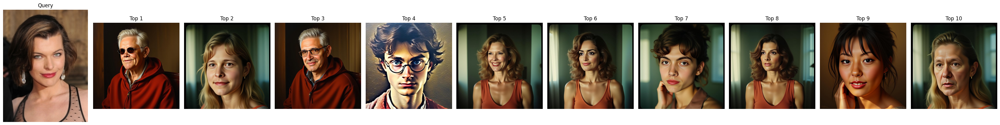

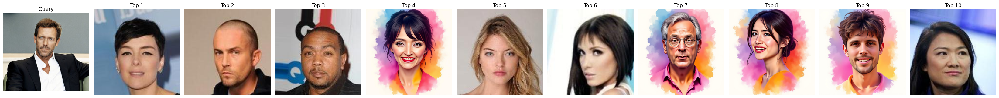

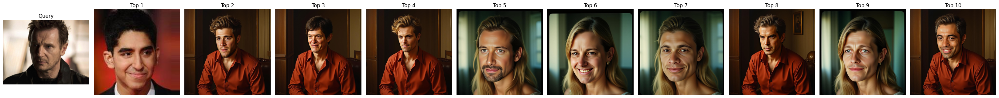

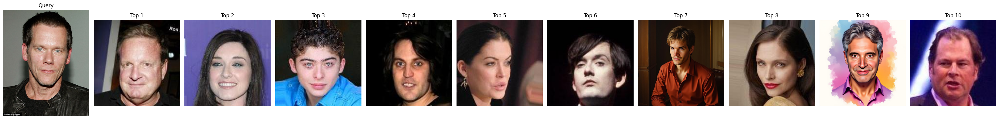

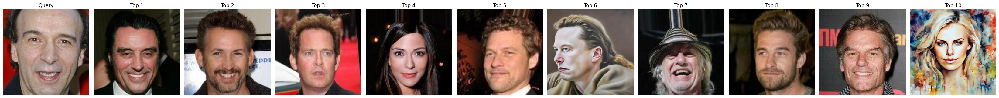

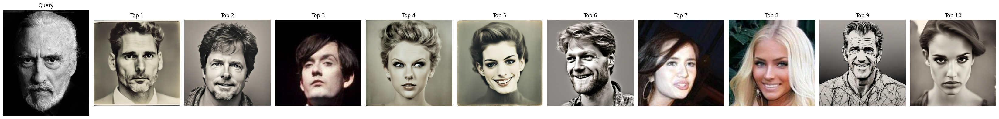

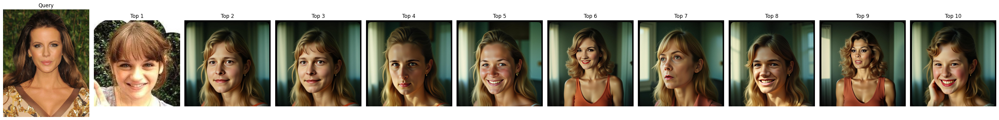

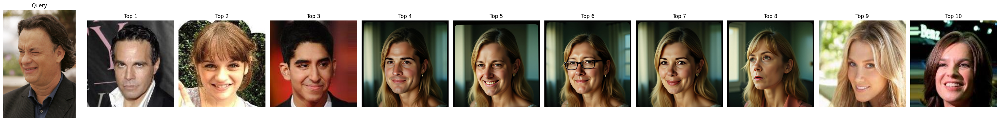

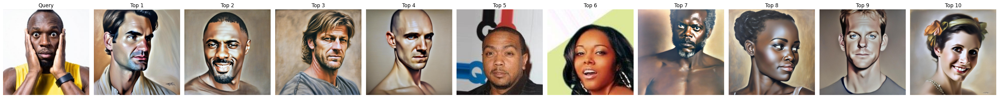

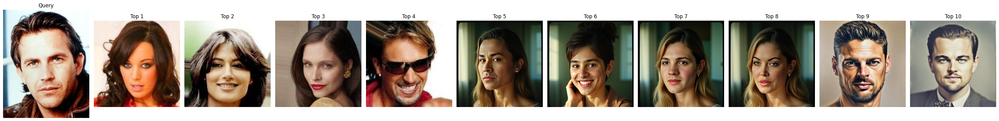

In [10]:
import json
import matplotlib.pyplot as plt
from PIL import Image

# Load submission file
with open('submission7.json', 'r') as f:
    results = json.load(f)

# How many queries to show?
num_queries_to_show = 10
top_k = len(results[0]['gallery_images'])

# Plot
for i, item in enumerate(results[:num_queries_to_show]):
    query_img = Image.open(item['filename']).convert('RGB')

    fig, axs = plt.subplots(1, top_k + 1, figsize=(3 * (top_k + 1), 4))
    axs[0].imshow(query_img)
    axs[0].set_title("Query")
    axs[0].axis('off')

    for j, gallery_path in enumerate(item['gallery_images']):
        gallery_img = Image.open(gallery_path).convert('RGB')
        axs[j + 1].imshow(gallery_img)
        axs[j + 1].set_title(f"Top {j+1}")
        axs[j + 1].axis('off')

    plt.tight_layout()
    plt.show()

In [5]:
import os
import cv2
import faiss
import numpy as np
from tqdm import tqdm
from insightface.app import FaceAnalysis

# === CONFIG ===
gallery_dir = "test/gallery"
query_dir = "test/query"
top_k = 10
res = dict()

# === Init InsightFace (con retinaface e ArcFace) ===
app = FaceAnalysis(name="buffalo_l", providers=["CPUExecutionProvider"])
app.prepare(ctx_id=0)

# === Caricamento immagini galleria e query ===
def get_all_images(folder):
    return [os.path.join(folder, f) for f in os.listdir(folder)
            if f.lower().endswith(('.jpg', '.jpeg', '.png'))]

gallery_paths = get_all_images(gallery_dir)
query_paths = get_all_images(query_dir)

# === Estrazione feature dalla galleria (solo primo volto trovato) ===
gallery_features = []
valid_gallery_paths = []

print("📸 Estrazione feature galleria...")
for path in tqdm(gallery_paths):
    img = cv2.imread(path)
    faces = app.get(img)
    if faces:
        gallery_features.append(faces[0].embedding)
        valid_gallery_paths.append(path)

gallery_features = np.array(gallery_features).astype('float32')

# === FAISS index ===
index = faiss.IndexFlatL2(gallery_features.shape[1])
index.add(gallery_features)

# === Query e costruzione del dizionario ===
print("🔍 Ricerca immagini simili...")
for q_path in tqdm(query_paths):
    img = cv2.imread(q_path)
    faces = app.get(img)
    if not faces:
        print(f"[!] Nessun volto in {q_path}")
        continue

    q_feat = faces[0].embedding.astype('float32').reshape(1, -1)
    distances, indices = index.search(q_feat, top_k)
    similar_images = [os.path.basename(valid_gallery_paths[i]) for i in indices[0]]
    query_key = os.path.basename(q_path)
    similar_images = list(dict.fromkeys([
    os.path.basename(valid_gallery_paths[i]) for i in indices[0]
]))
res[query_key] = similar_images

# === Output esempio ===
print("\n📋 Risultati (esempio):")
for k in list(res.keys())[:3]:
    print(f"{k}: {res[k]}")


Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
find model: /home/disi/.insightface/models/buffalo_l/1k3d68.onnx landmark_3d_68 ['None', 3, 192, 192] 0.0 1.0
Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
find model: /home/disi/.insightface/models/buffalo_l/2d106det.onnx landmark_2d_106 ['None', 3, 192, 192] 0.0 1.0
Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
find model: /home/disi/.insightface/models/buffalo_l/det_10g.onnx detection [1, 3, '?', '?'] 127.5 128.0
Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
find model: /home/disi/.insightface/models/buffalo_l/genderage.onnx genderage ['None', 3, 96, 96] 0.0 1.0
Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
find model: /home/disi/.insightface/models/buffalo_l/w600k_r50.onnx recognition ['None', 3, 112, 112] 127.5 127.5
set det-size

100%|██████████| 1480/1480 [14:23<00:00,  1.71it/s]


🔍 Ricerca immagini simili...


  1%|          | 17/1455 [00:11<11:33,  2.07it/s]

[!] Nessun volto in test/query/cb66333adcfa4ae8be4971309cd2117b.jpg


  1%|▏         | 19/1455 [00:11<09:23,  2.55it/s]

[!] Nessun volto in test/query/b639227fc23c4bccb9114a22024c7600.jpg


  2%|▏         | 29/1455 [00:19<17:16,  1.38it/s]

[!] Nessun volto in test/query/ce9261596ddf43ac9e77ddcfe9895952.jpg


  3%|▎         | 38/1455 [00:27<16:56,  1.39it/s]

[!] Nessun volto in test/query/c4acaf79a6374604ac6a72b38a3d5546.jpg


  3%|▎         | 39/1455 [00:27<14:45,  1.60it/s]

[!] Nessun volto in test/query/269890aceb0e470c869d41b44cdf996b.jpg


  3%|▎         | 42/1455 [00:29<13:34,  1.74it/s]

[!] Nessun volto in test/query/4c761ba787a34eeaa2463f14be8b3f66.jpg


  3%|▎         | 45/1455 [00:32<15:46,  1.49it/s]

[!] Nessun volto in test/query/898ad6fbecda46689b83196146ff9fe4.jpg


  5%|▍         | 68/1455 [00:49<16:45,  1.38it/s]

[!] Nessun volto in test/query/dd4a6c964f964435aab252c947548a98.jpg


  5%|▌         | 78/1455 [00:56<13:28,  1.70it/s]

[!] Nessun volto in test/query/699c72220754462da27c491b212f84f3.jpg


  6%|▌         | 85/1455 [01:01<12:17,  1.86it/s]

[!] Nessun volto in test/query/9b140d535150424d921382c24dff71e3.jpg


  6%|▌         | 87/1455 [01:02<11:31,  1.98it/s]

[!] Nessun volto in test/query/ceaaf67cdd504417a9d754a2ca0369df.jpg


  6%|▌         | 90/1455 [01:03<12:14,  1.86it/s]

[!] Nessun volto in test/query/039c642c7e094b039a5f845d3a05bada.jpg


  6%|▋         | 93/1455 [01:05<12:12,  1.86it/s]

[!] Nessun volto in test/query/e1871dbc87c14798b4d8822a37684635.jpg


  7%|▋         | 98/1455 [01:09<14:43,  1.54it/s]

[!] Nessun volto in test/query/da981bb831554e9aa79e86800500ad83.jpg


  7%|▋         | 109/1455 [01:18<16:59,  1.32it/s]

[!] Nessun volto in test/query/e36ce5d385a749b3b6b8b259d34b77fc.jpg


  8%|▊         | 119/1455 [01:25<13:05,  1.70it/s]

[!] Nessun volto in test/query/b06e569c737c4b0581bc1019e8df3280.jpg


  8%|▊         | 121/1455 [01:26<11:47,  1.88it/s]

[!] Nessun volto in test/query/93d881925ffb424abed02da11fa27a33.jpg


  9%|▉         | 132/1455 [01:32<07:36,  2.90it/s]

[!] Nessun volto in test/query/0d8be3c646394478a5f2b52bdca4414b.jpg
[!] Nessun volto in test/query/28d56226a6cd4a40924c25bc0592985c.jpg


  9%|▉         | 136/1455 [01:34<07:46,  2.83it/s]

[!] Nessun volto in test/query/7d58a242472d4217bbac9b86c295bb7d.jpg


 10%|▉         | 140/1455 [01:35<06:05,  3.60it/s]

[!] Nessun volto in test/query/e07a8b85b8c24d1b99cc26259ed80446.jpg


 10%|▉         | 145/1455 [01:36<05:02,  4.32it/s]

[!] Nessun volto in test/query/cd4b663a09b04d909b7a3fc4615715a5.jpg


 11%|█         | 153/1455 [01:39<06:45,  3.21it/s]

[!] Nessun volto in test/query/29b1856bda7a4c878dcd0e7c87e72f39.jpg


 11%|█         | 158/1455 [01:40<04:56,  4.38it/s]

[!] Nessun volto in test/query/00ec612f26db49e4911f9f8bc49cc572.jpg


 11%|█         | 161/1455 [01:41<05:46,  3.73it/s]

[!] Nessun volto in test/query/fc3bb2c0cab44c8bbca86d4660fb9a91.jpg


 11%|█▏        | 166/1455 [01:43<13:24,  1.60it/s]


KeyboardInterrupt: 

In [3]:
res

{'3ccb9e24e6124427ad71e41f4a637593.jpg': ['c010ab8acc8a447685cd9c279ebd693c.jpg',
  '2696fa9948f44509a7cc153a0b837a9c.jpg',
  '9f570b62ac904d3cb985b224f2707a59.jpg',
  '0aa5fc0f0f8d4e9bbe9a34552f1f7d79.jpg',
  '92b275e4f08041879e5d278e54ef27f4.jpg',
  '4a5858ac7e414f63b5e2c6881859da2e.jpg',
  '4512ded796d94fdd8e003536f3737b88.jpg',
  'ad06d833710644b6be058acac013e9bc.jpg',
  '1a64e03a05e94e7ba88ccbd6055c4d2e.jpg',
  '84ab24d36a1f4540bbdea6d21fea0e77.jpg'],
 'abeb4b77d7694bf9ab67761d7f485269.jpg': ['38a11e2295e3488092c28e6bf2fc48ba.jpg',
  '0bfc91cf1b10432e92dc48446e45efdd.jpg',
  'fef472e400de41a5a9f1bdbf3ebc90d4.jpg',
  'a8fe3232a139437fa6e61ee34c13d0a2.jpg',
  'e4b7c7f5a700483ebab3ecbd7e771270.jpg',
  '159d88ac3c2e4a1ab31259266943c063.jpg',
  'ad06d833710644b6be058acac013e9bc.jpg',
  'dde0c07b12484a4fad4cfc82b18c170f.jpg',
  '89b70ca9fe804e7abd08637a8fb0d7f3.jpg',
  '75687b577224414eb998fac93d09cbd7.jpg'],
 '1ff614f378134dd4bdf309a6a7a4bdf9.jpg': ['ad06d833710644b6be058acac013e9bc.jp

In [4]:
import json
import requests


def submit(results, groupname, url="http://65.108.245.177:3001/retrieval/"):
    res = {}
    res["groupname"] = groupname
    res["images"] = results
    res = json.dumps(res)
    # print(res)
    response = requests.post(url, res)
    try:
        result = json.loads(response.text)
        print(f"accuracy is {result['accuracy']}")
    except json.JSONDecodeError:
        print(f"ERROR: {response.text}")

submit(res, "STF")

ERROR: <html><body>Query list does not match</body></html>


In [ ]:
import os
import cv2
import faiss
import numpy as np
from tqdm import tqdm
from insightface.app import FaceAnalysis

# === CONFIG ===
gallery_dir = "test/gallery"
query_dir = "test/query"
top_k = 10
res = dict()

# === Init InsightFace (ArcFace + RetinaFace)
app = FaceAnalysis(name="buffalo_l", providers=["CPUExecutionProvider"])
app.prepare(ctx_id=0)

# === Utility: carica immagini da una cartella
def get_all_images(folder):
    return sorted([
        os.path.join(folder, f)
        for f in os.listdir(folder)
        if f.lower().endswith(('.jpg', '.jpeg', '.png'))
    ])

gallery_paths = get_all_images(gallery_dir)
query_paths = get_all_images(query_dir)

# === Estrai feature dalla galleria (solo 1 volto per immagine)
gallery_features = []
valid_gallery_paths = []

print("📸 Estrazione feature galleria...")
for path in tqdm(gallery_paths):
    img = cv2.imread(path)
    if img is None:
        print(f"[!] Immagine non valida: {path}")
        continue
    faces = app.get(img)
    if faces:
        gallery_features.append(faces[0].embedding)
        valid_gallery_paths.append(path)

if not gallery_features:
    raise RuntimeError("❌ Nessuna feature valida trovata nella galleria.")

gallery_features = np.array(gallery_features).astype('float32')

# === Costruisci indice FAISS
index = faiss.IndexFlatL2(gallery_features.shape[1])
index.add(gallery_features)

# === Analizza tutte le query
print("🔍 Ricerca immagini simili per ogni query...")
for q_path in tqdm(query_paths):
    img = cv2.imread(q_path)
    if img is None:
        print(f"[!] Immagine non valida: {q_path}")
        continue
    faces = app.get(img)
    if not faces:
        print(f"[!] Nessun volto trovato in {q_path}")
        continue

    q_feat = faces[0].embedding.astype('float32').reshape(1, -1)
    distances, indices = index.search(q_feat, min(top_k, len(valid_gallery_paths)))
    similar_images = [os.path.basename(valid_gallery_paths[i]) for i in indices[0]]
    res[os.path.basename(q_path)] = similar_images

# === Stampa esempio risultati
print("\n📋 Risultati (esempio):")
for k in list(res.keys())[:3]:
    print(f"{k}: {res[k]}")


In [ ]:
import json
import requests


def submit(results, groupname, url="http://65.108.245.177:3001/retrieval/"):
    res = {}
    res["groupname"] = groupname
    res["images"] = results
    res = json.dumps(res)
    # print(res)
    response = requests.post(url, res)
    try:
        result = json.loads(response.text)
        print(f"accuracy is {result['accuracy']}")
    except json.JSONDecodeError:
        print(f"ERROR: {response.text}")

submit(res, "STF")